# Tutorial 2

Design CosMx experiment for 2 kidney sections (a non-diseased and a T2D example)

Please download according demo data from following link and place it under the demo folder:

google drive: https://drive.google.com/drive/folders/1z1nk0sF_e25LKMyHxJVMtROFjuWet2G_?usp=drive_link

Please also download the checkpoint file for the pathology foundation model and place it under the checkpoints folder

# Step 1: Preprocess the H&E image

Make sure the physical size of each pixel is 0.5 micron

Image loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/he-raw.jpg
Rescaling image (scale: 1.000)...
305 sec
../demo/Tutorial_2_CosMx_FOV_selection_kidney/he-scaled.jpg
../demo/Tutorial_2_CosMx_FOV_selection_kidney/he.jpg
Preprocessed H&E image saved!


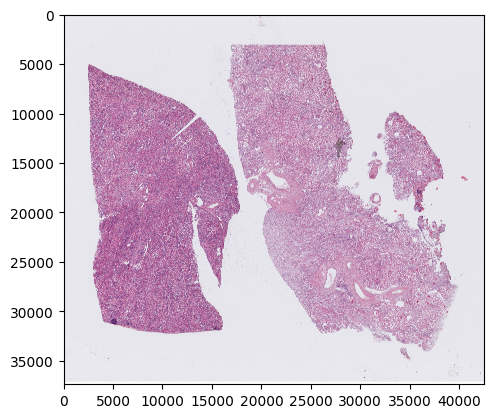

In [1]:
import sys
sys.path.append('../src')
from p1_histology_preprocess import histology_preprocess

prefix = '../demo/Tutorial_2_CosMx_FOV_selection_kidney/'
histology_preprocess(prefix, show_image=True)

# Step 2: Quality control for all superpixels

Superpixels are 8 microns * 8 microns square-shaped pseudo cells

We use our new QC package HistoSweep for this procedure

Image loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/he.jpg
0 0
../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/shapes.pickle
[compute_metrics_memory_optimized] Current memory: 0.2311 GB; Peak memory: 4.6564 GB
[compute_low_density_mask] Current memory: 0.0058 GB; Peak memory: 0.3760 GB
Total selected for density filtering:  363189
✅ Entropy map saved as 'glcm_entropy_map_colored.png'
✅ Energy map saved as 'glcm_energy_map_colored.png'
✅ Homogeneity map saved as 'glcm_homogeneity_map_colored.png'

=== GLCM Metric Means ===
   homogeneity    energy   entropy
0     0.386803  0.073254  0.778767
1     0.508877  0.148862  0.657161
2     0.283242  0.034037  0.877141
3     0.856751  0.458045  0.296625

=== Cluster Scores ===
Cluster 0: Score = -0.3187
Cluster 1: Score = 0.0006
Cluster 2: Score = -0.5599
Cluster 3: Score = 1.0182

=== Number of Observations per Cluster ===
Cluster 0: 87256
Cluster 1: 31992
Cluster 2: 130565
Cluster 3: 3230
Total: 253043

✅ 

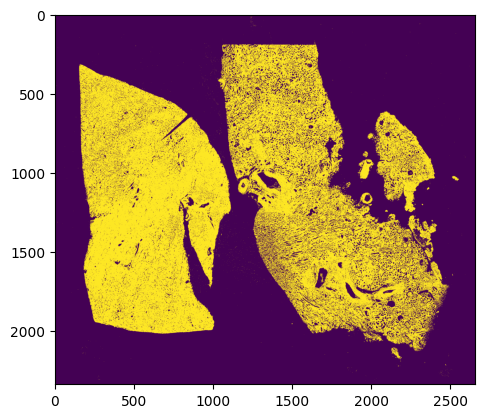

In [2]:
sys.path.append('../src/HistoSweep')
from p2_superpixel_quality_control import superpixel_quality_control

save_folder = '../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output'
superpixel_quality_control(prefix, save_folder, show_image=True)

# Step 3: Histology feature extraction

In [3]:
from p3_feature_extraction import histology_feature_extraction

# down_samp_step: the down-sampling step, 
# default = 10 refers to only extract features for superpixels whose row_index and col_index can both be divided by 10 (roughly 1:100 down-sampling rate). 
# down_samp_step = 1 means extract features for every superpixel
histology_feature_extraction(prefix, save_folder,
                             foundation_model='uni',
                             ckpt_path='../checkpoints/uni/',
                             device='cuda:1',
                             batch_size=32,
                             down_samp_step=10,
                             num_workers=4)

/data1/msyuan/anaconda3/envs/S2Omics/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Histology foundation model loaded! 
    Foundation model name: uni
    Start extracting histology feature embeddings...
Image loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/he.jpg
../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/num_patches.pickle


  0%|          | 0/1946 [00:00<?, ?it/s]

Batch 0:
Shape of patches: torch.Size([32, 3, 224, 224])
Shape of positions[0]: torch.Size([32])
Content of positions[0][:10]: tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0])
Content of positions[1][:10]: tensor([   0,  160,  320,  480,  640,  800,  960, 1120, 1280, 1440])
Shape of feature_emb: torch.Size([32, 197, 1024])
Shape of patch_emb: torch.Size([32, 1024, 14, 14])


100%|█████████▉| 1945/1946 [25:13<00:00,  1.28it/s]

Part 0 patch number: 62244


100%|██████████| 1946/1946 [25:15<00:00,  1.28it/s]

../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/uni_embeddings_downsamp_10_part_0.pickle


# Step 4: Histology segmentation

Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/shapes.pickle
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/qc_preserve_indicator.pickle
Loading histology feature embeddings...
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/uni_embeddings_downsamp_10_part_0.pickle
Sucessfully loaded and normalized all histology feature embeddings!
Start segmenting the histology image, clustering method: kmeans
../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/cluster_image.pickle
../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/linkage_matrix.pickle
Segmentation image is stored at: ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/image_files/cluster_image_num_clusters_20.jpg


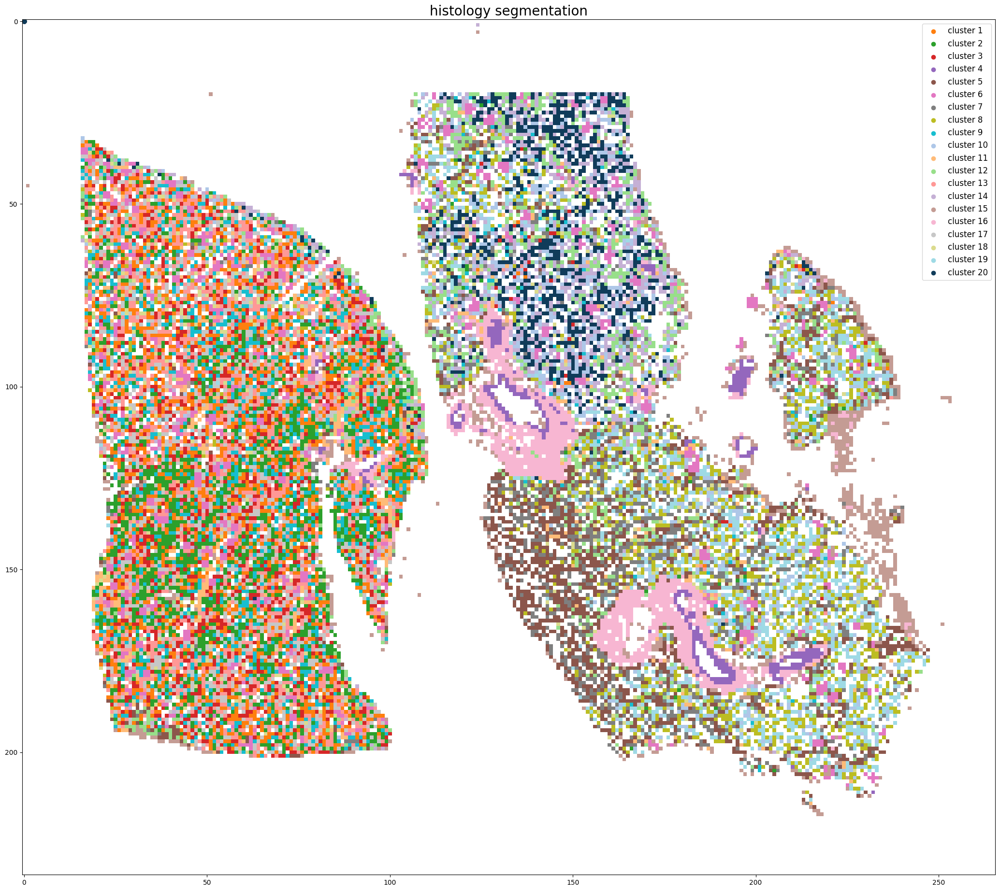

In [4]:
sys.path.append('../src/single_section')
from p4_get_histology_segmentation import get_histology_segmentation

get_histology_segmentation(prefix, save_folder,
                           foundation_model='uni', 
                           down_samp_step=10, 
                           clustering_method='kmeans',
                           n_clusters=20)

# Step 5: Merge over-clusters

Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/shapes.pickle
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/qc_preserve_indicator.pickle
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/cluster_image.pickle
Merging over-clusters...
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/linkage_matrix.pickle
../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/adjusted_cluster_image.pickle
Combined the original 20 clusters into 15 clusters.
Adjusted segmentation image is stored at: ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/image_files/adjusted_cluster_image_num_clusters_15.jpg


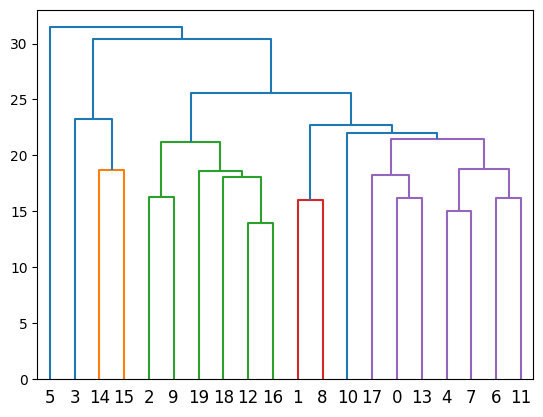

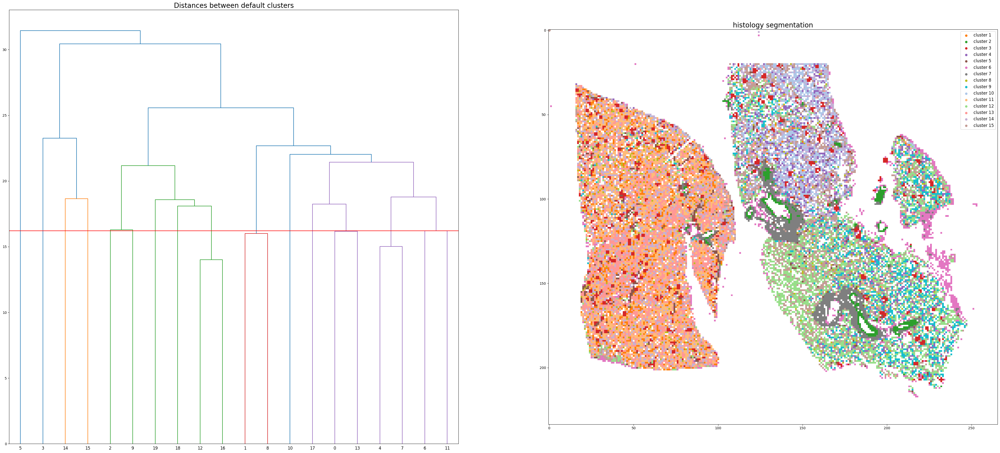

In [5]:
from p5_merge_over_clusters import merge_over_clusters

merge_over_clusters(prefix, save_folder,
                    target_n_clusters=15)

# Step 6: Select best ROI for CosMx experiment

Image loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/he.jpg
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/shapes.pickle
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/qc_preserve_indicator.pickle
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/adjusted_cluster_image.pickle
Sampling ROI candidates...


100%|██████████| 1600/1600 [00:00<00:00, 3243.81it/s]


Current best ROI: [[[51, 80], [113, 80], [113, 142], [51, 142]]]
    roi score: 0.7310565501632443
    scale score: 0.555703635936308
    valid score: 0.8170274285105769
    balance score: 0.8605439252241127
Current number of ROIs is 1.


100%|██████████| 1600/1600 [00:00<00:00, 2260.44it/s]


Current best ROI: [[[134, 167], [196, 167], [196, 229], [134, 229]], [[70, 38], [132, 38], [132, 100], [70, 100]]]
    roi score: 0.7769145672056587
    scale score: 0.6372115988605451
    valid score: 0.9166627250569562
    balance score: 0.8028354660177291
Current number of ROIs is 2.
Find the best 2 ROI(s) with: 
    ROI score: 0.7769145672056587
    Scale score: 0.6372115988605451
    Coverage score: 0.9166627250569562
    Balance score: 0.8028354660177291
    
../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/roi_selection_detailed_output/rectangle_roi_size_5.0_5.0/prior_preference_1/best_roi.pickle
Best ROI on histology segmentation image is stored at ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/main_output/best_roi_on_histology_segmentations.jpg
Best ROI on H&E image is stored at ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/main_output/best_roi_on_he.jpg


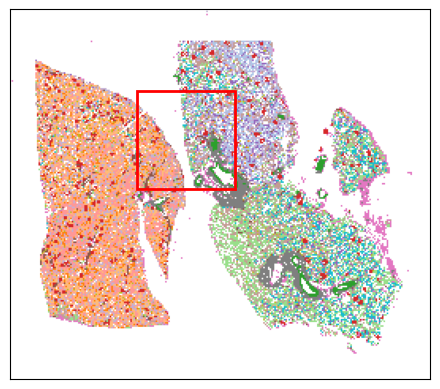

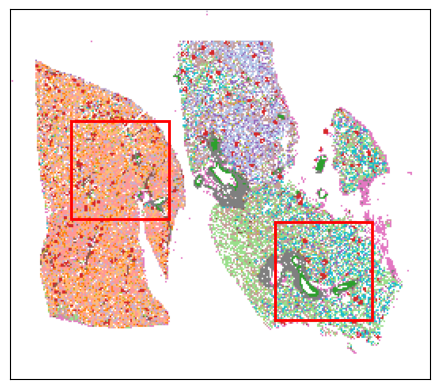

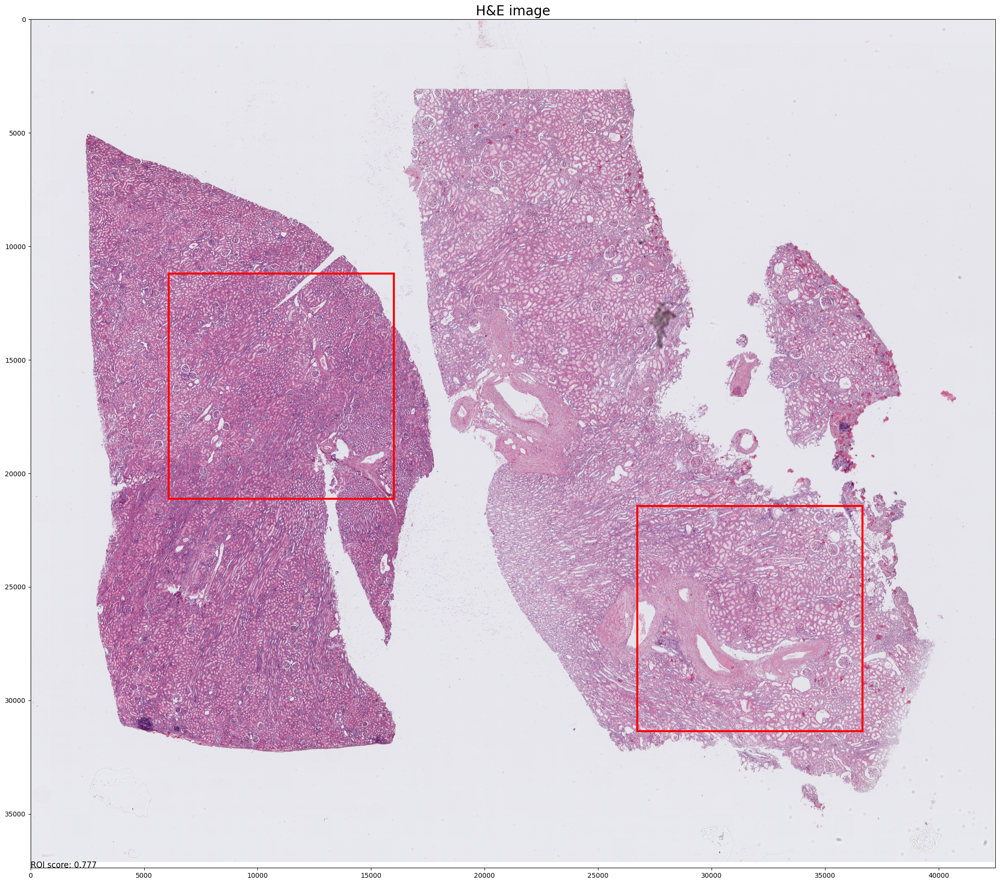

In [8]:
from p6_roi_selection_rectangle import roi_selection_for_single_section

# fusion_weights: the weight of three scores, default=[0.33,0.33,0.33], the sum of three weights should be equal to 1 (if not they will be normalized)
# positive_prior, negative_prior: prior information about interested and not-interested histology clusters, default = [],[]
# prior_preference: the larger this parameter is, S2Omics will focus more on those interested histology clusters, default=  1
roi_selection_for_single_section(prefix, save_folder,
                                 down_samp_step=10,
                                 roi_size=[5.0, 5.0],
                                 rotation_seg=1, 
                                 num_roi=2, #0 refers to automatiacally determine the number of ROI
                                 fusion_weights=[0.33,0.33,0.33],
                                 emphasize_clusters=[], discard_clusters=[],
                                 prior_preference=1)

# Step 6: Select best FOV for CosMx experiment

Image loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/he.jpg
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/shapes.pickle
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/qc_preserve_indicator.pickle
Pickle loaded from ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/pickle_files/adjusted_cluster_image.pickle
Sampling ROI candidates...


100%|██████████| 161500/161500 [00:40<00:00, 3991.94it/s]


Current best ROI: [[[90, 79], [96, 79], [96, 85], [90, 85]]]
    roi score: 0.7633475484886637
    scale score: 0.5009155502694107
    valid score: 1.0801234497346435
    balance score: 0.822108307320585
Current number of ROIs is 1.


100%|██████████| 161500/161500 [00:53<00:00, 3016.51it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]]]
    roi score: 0.787598960569605
    scale score: 0.5019400870502737
    valid score: 1.1118053386771947
    balance score: 0.8754568922558981
Current number of ROIs is 2.


100%|██████████| 161500/161500 [00:43<00:00, 3678.73it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[82, 130], [88, 130], [88, 136], [82, 136]]]
    roi score: 0.812938278953803
    scale score: 0.5029428094598825
    valid score: 1.1180339887498947
    balance score: 0.955430522380051
Current number of ROIs is 3.


100%|██████████| 161500/161500 [00:55<00:00, 2899.88it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]]]
    roi score: 0.8125264573239902
    scale score: 0.5039019132026529
    valid score: 1.114924013354971
    balance score: 0.9548194500023122
Current number of ROIs is 4.


100%|██████████| 161500/161500 [00:45<00:00, 3577.16it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[98, 86], [104, 86], [104, 92], [98, 92]]]
    roi score: 0.8192685651529936
    scale score: 0.5049481752012746
    valid score: 1.122992035194868
    balance score: 0.9697401824895223
Current number of ROIs is 5.


100%|██████████| 161500/161500 [00:57<00:00, 2826.80it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]]]
    roi score: 0.8189404034709604
    scale score: 0.5059508024050038
    valid score: 1.1242281302693367
    balance score: 0.9655931082325341
Current number of ROIs is 6.


100%|██████████| 161500/161500 [00:47<00:00, 3391.30it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[114, 78], [120, 78], [120, 84], [114, 84]]]
    roi score: 0.8210495413616404
    scale score: 0.506844408296478
    valid score: 1.116257920926766
    balance score: 0.9782928406968969
Current number of ROIs is 7.


100%|██████████| 161500/161500 [00:59<00:00, 2706.47it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]]]
    roi score: 0.8207920254957598
    scale score: 0.5079994917493161
    valid score: 1.1288514320120056
    balance score: 0.9642714735213632
Current number of ROIs is 8.


100%|██████████| 161500/161500 [00:51<00:00, 3146.19it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[137, 30], [143, 30], [143, 36], [137, 36]]]
    roi score: 0.8241116396047302
    scale score: 0.5090673233929748
    valid score: 1.133115447465063
    balance score: 0.9703061032238947
Current number of ROIs is 9.


100%|██████████| 161500/161500 [01:01<00:00, 2634.28it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]]]
    roi score: 0.8248393594492931
    scale score: 0.5100479124609589
    valid score: 1.131616346451197
    balance score: 0.9722947532787561
Current number of ROIs is 10.


100%|██████████| 161500/161500 [00:53<00:00, 2992.21it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[66, 64], [72, 64], [72, 70], [66, 70]]]
    roi score: 0.8271930155786374
    scale score: 0.5110720005970698
    valid score: 1.1326200964261064
    balance score: 0.9778094376503255
Current number of ROIs is 11.


100%|██████████| 161500/161500 [01:05<00:00, 2474.15it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]]]
    roi score: 0.826932449233488
    scale score: 0.5119870648162649
    valid score: 1.12833866731055
    balance score: 0.9788398514091579
Current number of ROIs is 12.


100%|██████████| 161500/161500 [00:55<00:00, 2893.52it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]], [[153, 184], [159, 184], [159, 190], [153, 190]]]
    roi score: 0.8274729859725922
    scale score: 0.5129238329990933
    valid score: 1.125652707141069
    balance score: 0.9813053676353111
Current number of ROIs is 13.


100%|██████████| 161500/161500 [01:06<00:00, 2416.17it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]], [[66, 63], [72, 63], [72, 69], [66, 69]], [[134, 189], [140, 189], [140, 195], [134, 195]]]
    roi score: 0.8272412229518037
    scale score: 0.5138605104011754
    valid score: 1.123345344008138
    balance score: 0.9807040536422298
Current number of ROIs is 14.


100%|██████████| 161500/161500 [00:56<00:00, 2842.40it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]], [[66, 63], [72, 63], [72, 69], [66, 69]], [[134, 189], [140, 189], [140, 195], [134, 195]], [[82, 129], [88, 129], [88, 135], [82, 135]]]
    roi score: 0.8289222577541624
    scale score: 0.5148842089964513
    valid score: 1.1246398600506808
    balance score: 0.9835996354502596
Current number of ROIs is 15.


100%|██████████| 161500/161500 [01:08<00:00, 2353.15it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]], [[66, 63], [72, 63], [72, 69], [66, 69]], [[134, 189], [140, 189], [140, 195], [134, 195]], [[154, 184], [160, 184], [160, 190], [154, 190]], [[83, 129], [89, 129], [89, 135], [83, 135]]]
    roi score: 0.8285770395903097
    scale score: 0.5157988980842599
    valid score: 1.1219093348196882
    balance score: 0.9830158311427499
Current number of ROIs is 16.


100%|██████████| 161500/161500 [00:58<00:00, 2777.12it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]], [[66, 63], [72, 63], [72, 69], [66, 69]], [[134, 189], [140, 189], [140, 195], [134, 195]], [[154, 184], [160, 184], [160, 190], [154, 190]], [[83, 129], [89, 129], [89, 135], [83, 135]], [[110, 83], [116, 83], [116, 89], [110, 89]]]
    roi score: 0.8288648028214629
    scale score: 0.5167570301718512
    valid score: 1.1209531425141812
    balance score: 0.983053698685127
Current number of ROIs is 17.


100%|██████████| 161500/161500 [01:09<00:00, 2311.45it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]], [[66, 63], [72, 63], [72, 69], [66, 69]], [[134, 189], [140, 189], [140, 195], [134, 195]], [[154, 184], [160, 184], [160, 190], [154, 190]], [[83, 129], [89, 129], [89, 135], [83, 135]], [[94, 149], [100, 149], [100, 155], [94, 155]], [[189, 25], [195, 25], [195, 31], [189, 31]]]
    roi score: 0.828820461009692
    scale score: 0.5178021244377278
    valid score: 1.1228546073004297
    balance score: 0.9792510

100%|██████████| 161500/161500 [01:01<00:00, 2636.88it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]], [[66, 63], [72, 63], [72, 69], [66, 69]], [[134, 189], [140, 189], [140, 195], [134, 195]], [[154, 184], [160, 184], [160, 190], [154, 190]], [[83, 129], [89, 129], [89, 135], [83, 135]], [[94, 149], [100, 149], [100, 155], [94, 155]], [[189, 25], [195, 25], [195, 31], [189, 31]], [[110, 83], [116, 83], [116, 89], [110, 89]]]
    roi score: 0.8295245891307287
    scale score: 0.5187599909369824
    valid score: 

100%|██████████| 161500/161500 [01:12<00:00, 2232.58it/s]


Current best ROI: [[[124, 187], [130, 187], [130, 193], [124, 193]], [[149, 22], [155, 22], [155, 28], [149, 28]], [[55, 142], [61, 142], [61, 148], [55, 148]], [[163, 183], [169, 183], [169, 189], [163, 189]], [[99, 87], [105, 87], [105, 93], [99, 93]], [[165, 193], [171, 193], [171, 199], [165, 199]], [[66, 164], [72, 164], [72, 170], [66, 170]], [[105, 221], [111, 221], [111, 227], [105, 227]], [[172, 213], [178, 213], [178, 219], [172, 219]], [[152, 48], [158, 48], [158, 54], [152, 54]], [[59, 121], [65, 121], [65, 127], [59, 127]], [[91, 54], [97, 54], [97, 60], [91, 60]], [[66, 63], [72, 63], [72, 69], [66, 69]], [[134, 189], [140, 189], [140, 195], [134, 195]], [[154, 184], [160, 184], [160, 190], [154, 190]], [[83, 129], [89, 129], [89, 135], [83, 135]], [[94, 149], [100, 149], [100, 155], [94, 155]], [[189, 25], [195, 25], [195, 31], [189, 31]], [[157, 194], [163, 194], [163, 200], [157, 200]], [[133, 96], [139, 96], [139, 102], [133, 102]]]
    roi score: 0.8296018153947646
 

/data1/msyuan/S2Omics/notebooks/../src/single_section/p6_roi_selection_rectangle.py:367: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=plt_figsize)


Best ROI on histology segmentation image is stored at ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/main_output/best_roi_on_histology_segmentations.jpg


/data1/msyuan/S2Omics/notebooks/../src/single_section/p6_roi_selection_rectangle.py:402: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=plt_figsize)


Best ROI on H&E image is stored at ../demo/Tutorial_2_CosMx_FOV_selection_kidney/S2Omics_output/main_output/best_roi_on_he.jpg


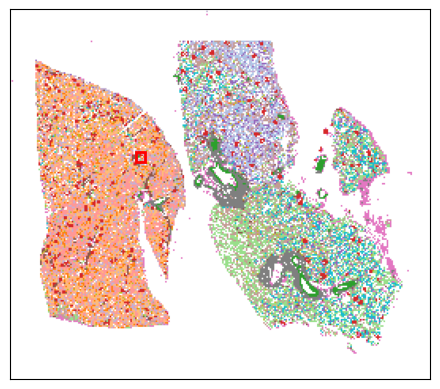

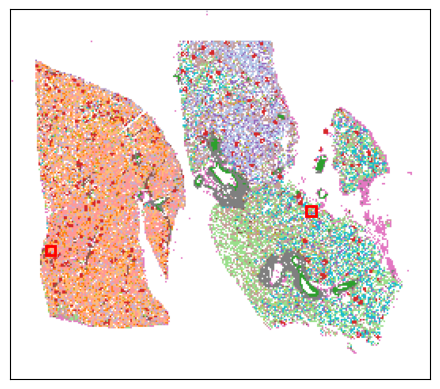

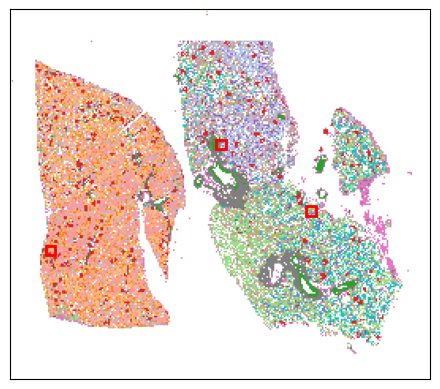

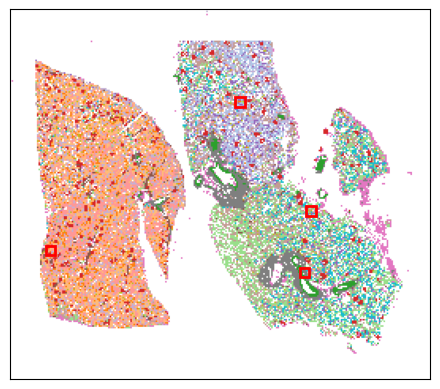

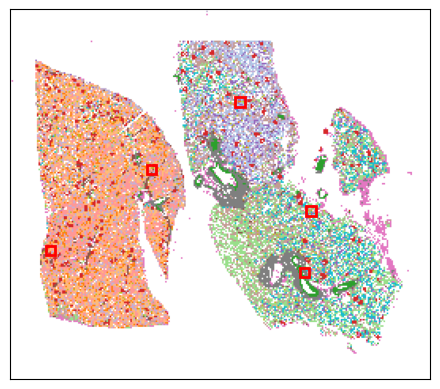

...

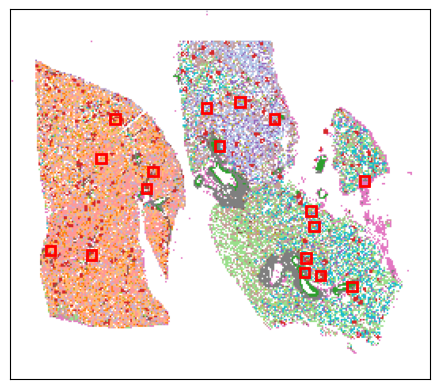

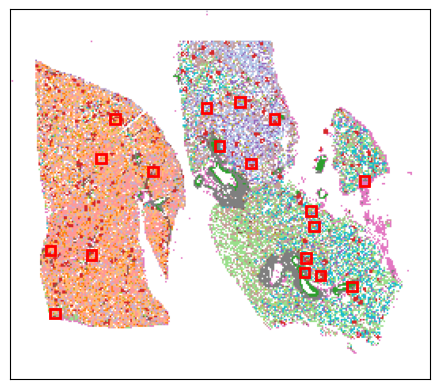

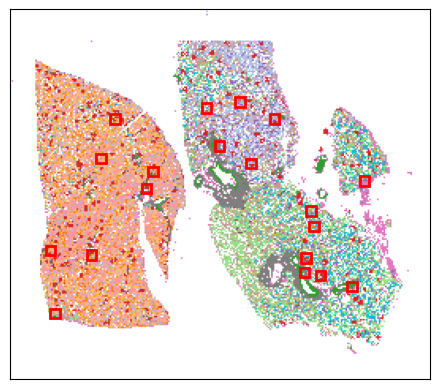

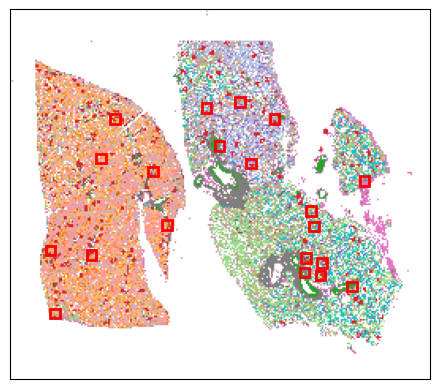

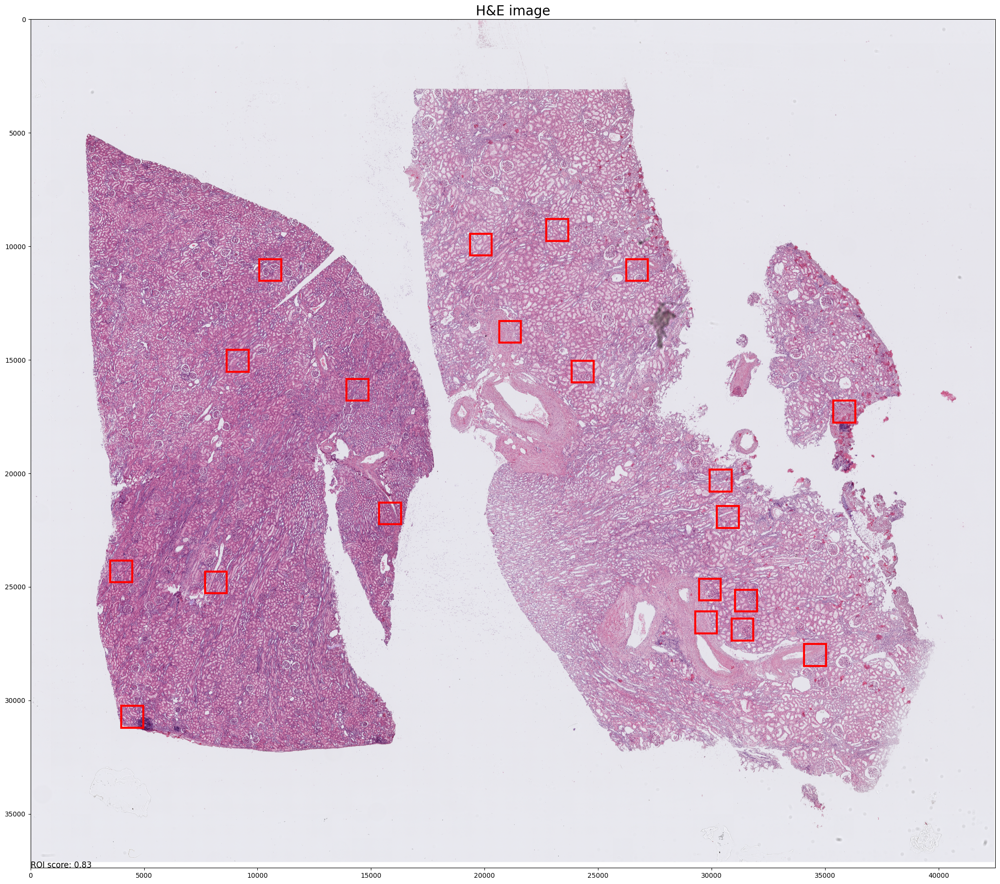

In [9]:
from p6_roi_selection_rectangle import roi_selection_for_single_section

# fusion_weights: the weight of three scores, default=[0.33,0.33,0.33], the sum of three weights should be equal to 1 (if not they will be normalized)
# positive_prior, negative_prior: prior information about interested and not-interested histology clusters, default = [],[]
# prior_preference: the larger this parameter is, S2Omics will focus more on those interested histology clusters, default=  1
roi_selection_for_single_section(prefix, save_folder,
                                 down_samp_step=10,
                                 roi_size=[0.5, 0.5],
                                 rotation_seg=1, 
                                 num_roi=20, #0 refers to automatiacally determine the number of ROI
                                 fusion_weights=[0.33,0.33,0.33],
                                 emphasize_clusters=[], discard_clusters=[],
                                 prior_preference=1)